# Notebook to run basic analysis on Raw data before cellbender

**Created by :** Srivalli Kolla

**Created on :** 12 August, 2024

**Modified on :** 16 October, 2024

**Institute of SystemsImmunology, University of Würuburg**

Env : scanpy(Python 3.12.4)

# Importing packages

In [1]:
import anndata as ad
import scanpy as sc
import os
import datetime
import bbknn
import random
import matplotlib.pyplot as plt
import numpy as np
import pandas as pd
import seaborn as sns
from scipy.stats import median_abs_deviation

In [2]:
sc.settings.verbosity = 3
sc.logging.print_versions()
sc.settings.set_figure_params(dpi = 300, color_map = 'RdPu', dpi_save = 300, vector_friendly = True, format = 'svg')

timestamp = datetime.datetime.now().strftime("%d_%m_%y")

-----
anndata     0.10.8
scanpy      1.10.2
-----
PIL                 10.3.0
annoy               NA
asttokens           NA
attr                23.2.0
bbknn               1.6.0
cffi                1.16.0
colorama            0.4.6
comm                0.2.2
cycler              0.12.1
cython_runtime      NA
dateutil            2.9.0.post0
debugpy             1.8.2
decorator           5.1.1
defusedxml          0.7.1
distutils           3.12.4
django              5.0.6
executing           2.0.1
h5py                3.11.0
igraph              0.11.5
ipykernel           6.29.5
ipython_genutils    0.2.0
ipywidgets          8.1.3
jedi                0.19.1
joblib              1.4.2
kiwisolver          1.4.5
legacy_api_wrap     NA
leidenalg           0.10.2
llvmlite            0.43.0
louvain             0.8.2
matplotlib          3.8.4
mpl_toolkits        NA
natsort             8.4.0
numba               0.60.0
numexpr             2.10.1
numpy               1.26.4
packaging           24.1
pandas    

# Data loading and Preprocessing

In [3]:
before_cb_raw = sc.read_h5ad(f'../../raw_data/raw_anndatas/dmd_merged_filtered_qc_before_cb_09_09_2024.h5ad')
before_cb_raw

/home/skolla/miniforge3/envs/scanpy/lib/python3.12/site-packages/anndata/_core/anndata.py:1818: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")


AnnData object with n_obs × n_vars = 349081 × 32285
    obs: 'sample', 'genotype', 'n_genes_by_counts', 'total_counts', 'total_counts_mt', 'pct_counts_mt', 'total_counts_ribo', 'pct_counts_ribo'
    var: 'mt', 'ribo', 'n_cells_by_counts', 'mean_counts', 'pct_dropout_by_counts', 'total_counts'
    uns: 'sample_colors'
    layers: 'counts', 'sqrt_norm'

In [4]:
ref = sc.read_h5ad('../../data/annotated_dmd_ref_filtered_dmd_09_09_24.h5ad')
ref

/home/skolla/miniforge3/envs/scanpy/lib/python3.12/site-packages/anndata/_core/anndata.py:1818: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")


AnnData object with n_obs × n_vars = 117208 × 16060
    obs: 'cell_source', 'cell_type', 'donor', 'n_counts', 'n_genes', 'percent_mito', 'percent_ribo', 'region', 'sample', 'scrublet_score', 'cell_states', 'seed_labels', 'genotype', 'batch', 'doublet_scores', 'n_genes_by_counts', 'total_counts', 'total_counts_mt', 'pct_counts_mt', 'total_counts_ribo', 'pct_counts_ribo', 'percent_mt2', 'percent_chrY', 'XIST-counts', 'S_score', 'G2M_score', '_scvi_batch', '_scvi_labels', 'cell_type-broad'
    var: 'highly_variable', 'highly_variable_rank', 'means', 'variances', 'variances_norm', 'highly_variable_nbatches'
    uns: 'cell_type-broad_colors', 'hvg', 'neighbors', 'pca', 'sample_colors', 'umap'
    obsm: 'X_pca', 'X_scANVI', 'X_scVI', 'X_umap'
    varm: 'PCs'
    obsp: 'connectivities', 'distances'

In [5]:
def X_is_raw(adata):
    return np.array_equal(adata.X.sum(axis=0).astype(int), adata.X.sum(axis=0))

is_raw = X_is_raw(before_cb_raw)
print(is_raw)

True


### HVG

In [6]:
sc.pp.filter_cells(before_cb_raw, min_counts = 200)
before_cb_raw

/home/skolla/miniforge3/envs/scanpy/lib/python3.12/site-packages/anndata/_core/anndata.py:1818: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")


AnnData object with n_obs × n_vars = 349081 × 32285
    obs: 'sample', 'genotype', 'n_genes_by_counts', 'total_counts', 'total_counts_mt', 'pct_counts_mt', 'total_counts_ribo', 'pct_counts_ribo', 'n_counts'
    var: 'mt', 'ribo', 'n_cells_by_counts', 'mean_counts', 'pct_dropout_by_counts', 'total_counts'
    uns: 'sample_colors'
    layers: 'counts', 'sqrt_norm'

In [7]:
sc.pp.highly_variable_genes(before_cb_raw,flavor = "seurat_v3", batch_key= 'sample')
before_cb_raw

extracting highly variable genes
--> added
    'highly_variable', boolean vector (adata.var)
    'highly_variable_rank', float vector (adata.var)
    'means', float vector (adata.var)
    'variances', float vector (adata.var)
    'variances_norm', float vector (adata.var)


AnnData object with n_obs × n_vars = 349081 × 32285
    obs: 'sample', 'genotype', 'n_genes_by_counts', 'total_counts', 'total_counts_mt', 'pct_counts_mt', 'total_counts_ribo', 'pct_counts_ribo', 'n_counts'
    var: 'mt', 'ribo', 'n_cells_by_counts', 'mean_counts', 'pct_dropout_by_counts', 'total_counts', 'highly_variable', 'highly_variable_rank', 'means', 'variances', 'variances_norm', 'highly_variable_nbatches'
    uns: 'sample_colors', 'hvg'
    layers: 'counts', 'sqrt_norm'

### Normalization

In [8]:
sc.pp.normalize_total(before_cb_raw, target_sum= 1e6)
sc.pp.log1p(before_cb_raw)
before_cb_raw.layers["normalized"] = before_cb_raw.X.copy()

normalizing counts per cell


    finished (0:00:00)


In [9]:
before_cb_raw

AnnData object with n_obs × n_vars = 349081 × 32285
    obs: 'sample', 'genotype', 'n_genes_by_counts', 'total_counts', 'total_counts_mt', 'pct_counts_mt', 'total_counts_ribo', 'pct_counts_ribo', 'n_counts'
    var: 'mt', 'ribo', 'n_cells_by_counts', 'mean_counts', 'pct_dropout_by_counts', 'total_counts', 'highly_variable', 'highly_variable_rank', 'means', 'variances', 'variances_norm', 'highly_variable_nbatches'
    uns: 'sample_colors', 'hvg', 'log1p'
    layers: 'counts', 'sqrt_norm', 'normalized'

### Batch correction

In [10]:
sc.pp.pca(before_cb_raw, n_comps = 50, use_highly_variable = True, svd_solver = 'arpack', random_state = 1712)
sc.pp.neighbors(before_cb_raw, use_rep = "X_pca", n_neighbors = 50, metric = 'minkowski', random_state = 1786)
bbknn_raw_before_cb_raw = bbknn.bbknn(before_cb_raw, neighbors_within_batch = 4, batch_key = 'sample', approx = True, copy = True)

computing PCA
    with n_comps=50


/home/skolla/miniforge3/envs/scanpy/lib/python3.12/site-packages/scanpy/preprocessing/_pca.py:385: FutureWarning: Argument `use_highly_variable` is deprecated, consider using the mask argument. Use_highly_variable=True can be called through mask_var="highly_variable". Use_highly_variable=False can be called through mask_var=None
  warn(msg, FutureWarning)


    finished (0:00:06)
computing neighbors
    finished: added to `.uns['neighbors']`
    `.obsp['distances']`, distances for each pair of neighbors
    `.obsp['connectivities']`, weighted adjacency matrix (0:02:36)
computing batch balanced neighbors


/home/skolla/miniforge3/envs/scanpy/lib/python3.12/site-packages/anndata/_core/anndata.py:1818: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")


	finished: added to `.uns['neighbors']`
    `.obsp['distances']`, distances for each pair of neighbors
    `.obsp['connectivities']`, weighted adjacency matrix (0:00:33)


In [11]:
def X_is_raw(adata):
    return np.array_equal(adata.X.sum(axis=0).astype(int), adata.X.sum(axis=0))

is_raw = X_is_raw(bbknn_raw_before_cb_raw)
print(is_raw)

False


### Visualization of Counts of Genes from Empty droplets

1. Define list of genes from empty droplets
2. Select genes which are present in my data
3. Filter the data based on the genes present
4. Calculate Sum the log-transformed values for each gene, round them up  and convert to dataframe
5. plot the values

/tmp/ipykernel_34129/4292011268.py:14: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  bar_plot = sns.barplot(x='Gene', y='Log Total Counts', data=log_total_counts_df, palette='viridis')


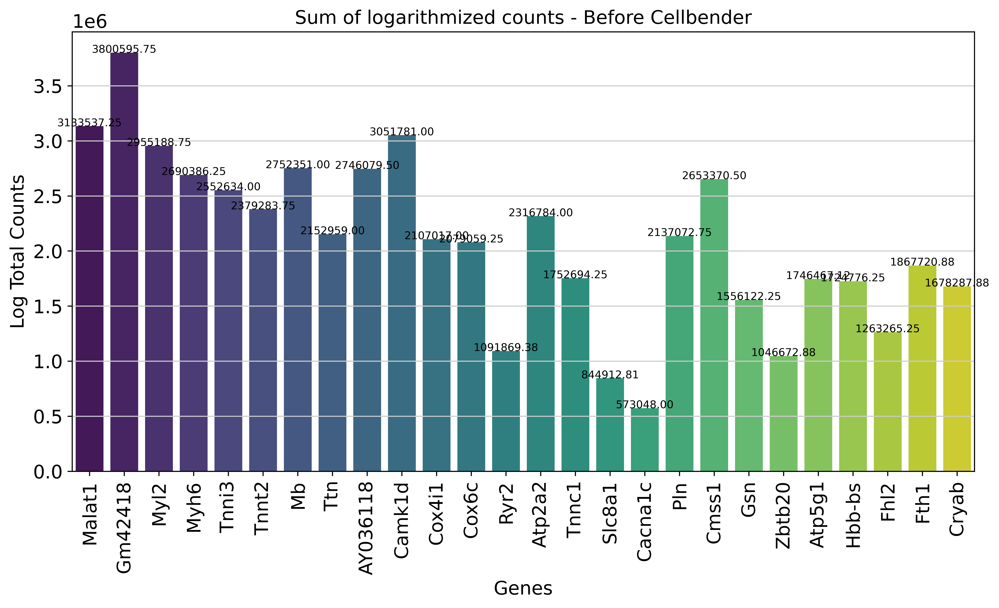

,Gene,Log Total Counts
0,Malat1,3.133537e+06
1,Gm42418,3.800596e+06
2,Myl2,2.955189e+06
3,Myh6,2.690386e+06
4,Tnni3,2.552634e+06
5,Tnnt2,2.379284e+06
6,Mb,2.752351e+06
7,Ttn,2.152959e+06
8,AY036118,2.746080e+06
9,Camk1d,3.051781e+06


In [12]:
genes_empty_droplets = ['Malat1', 'Gm42418', 'Myl2', 'Myh6', 'Tnni3', 'Tnnt2', 'Mb', 'Ttn', 'AY036118', 'Camk1d',
                        'Cox4i1', 'Cox6c', 'Ryr2', 'Atp2a2', 'Tnnc1', 'Slc8a1', 'Cacna1c', 'Pln', 'Cmss1',
                        'Gsn', 'Zbtb20', 'Atp5g1', 'Hbb-bs', 'Fhl2', 'Fth1', 'Cryab']

present_empty_genes = [gene for gene in genes_empty_droplets if gene in bbknn_raw_before_cb_raw.var.index]

log_gene_expression_data = bbknn_raw_before_cb_raw[:, present_empty_genes].layers["normalized"]
gene_expression_df = pd.DataFrame(log_gene_expression_data.toarray(), columns=present_empty_genes)

log_total_counts_per_gene = gene_expression_df.sum(axis=0)
log_total_counts_df = pd.DataFrame({'Gene': log_total_counts_per_gene.index, 'Log Total Counts': log_total_counts_per_gene.values})

plt.figure(figsize=(12, 6))
bar_plot = sns.barplot(x='Gene', y='Log Total Counts', data=log_total_counts_df, palette='viridis')
for index, row in log_total_counts_df.iterrows():
    bar_plot.text(index, row['Log Total Counts'] + 0.1, f"{row['Log Total Counts']:.2f}", color='black', ha="center", fontsize=8)

plt.xticks(rotation=90)
plt.title('Sum of logarithmized counts - Before Cellbender')
plt.xlabel('Genes')
plt.ylabel('Log Total Counts')
plt.show()

log_total_counts_df

/tmp/ipykernel_34129/3862605996.py:11: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x='Gene', y='Mean Expression', data=gene_mean_expression_df, palette='viridis')


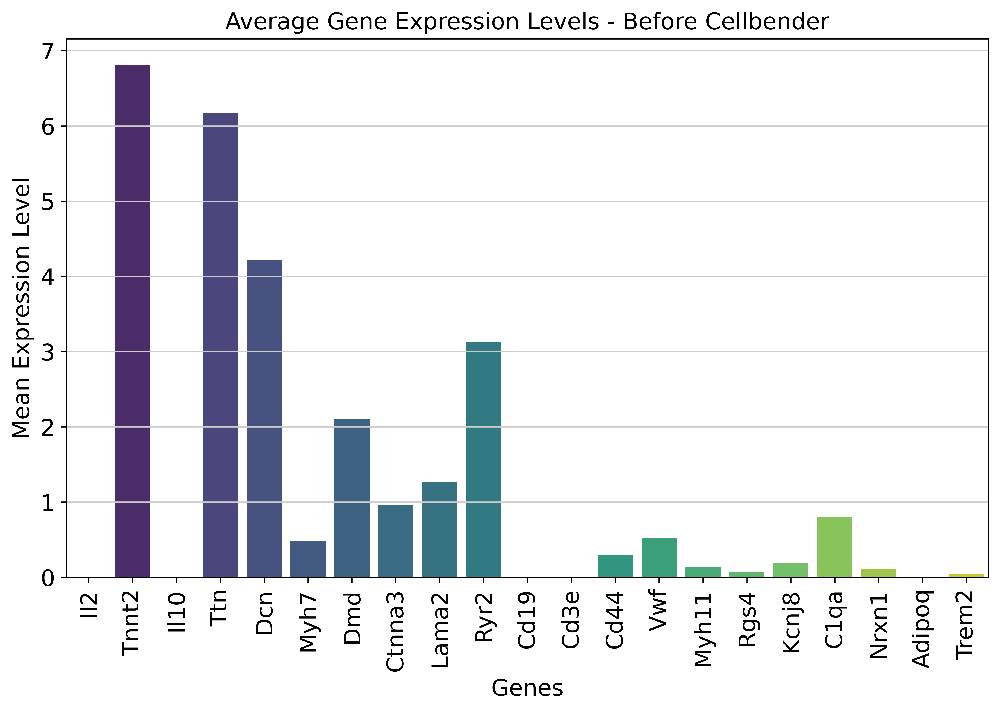

In [13]:
genes_of_interest = ['Il2','Tnnt2','Il10', 'Ttn','Dcn','Myh7', 'Dmd','Ctnna3','Lama2','Ryr2','Cd19','Cd3e','Cd44', 'Vwf', 'Myh11', 'Rgs4', 'Kcnj8', 'C1qa', 'Nrxn1', 'Adipoq', 'Trem2']
present_genes = [gene for gene in genes_of_interest if gene in bbknn_raw_before_cb_raw.var.index]

gene_expression_data = bbknn_raw_before_cb_raw[:, present_genes].X
gene_expression_df = pd.DataFrame(gene_expression_data.toarray(), columns=present_genes)

gene_mean_expression = gene_expression_df.mean(axis=0)
gene_mean_expression_df = pd.DataFrame({'Gene': gene_mean_expression.index, 'Mean Expression': gene_mean_expression.values})

plt.figure(figsize=(10, 6))
sns.barplot(x='Gene', y='Mean Expression', data=gene_mean_expression_df, palette='viridis')
plt.xticks(rotation=90)
plt.title('Average Gene Expression Levels - Before Cellbender')
plt.xlabel('Genes')
plt.ylabel('Mean Expression Level')
plt.show()

/tmp/ipykernel_34129/3469691559.py:11: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  bar_plot = sns.barplot(x='Gene', y='Mean Expression', data=gene_mean_expression_df, palette='viridis')


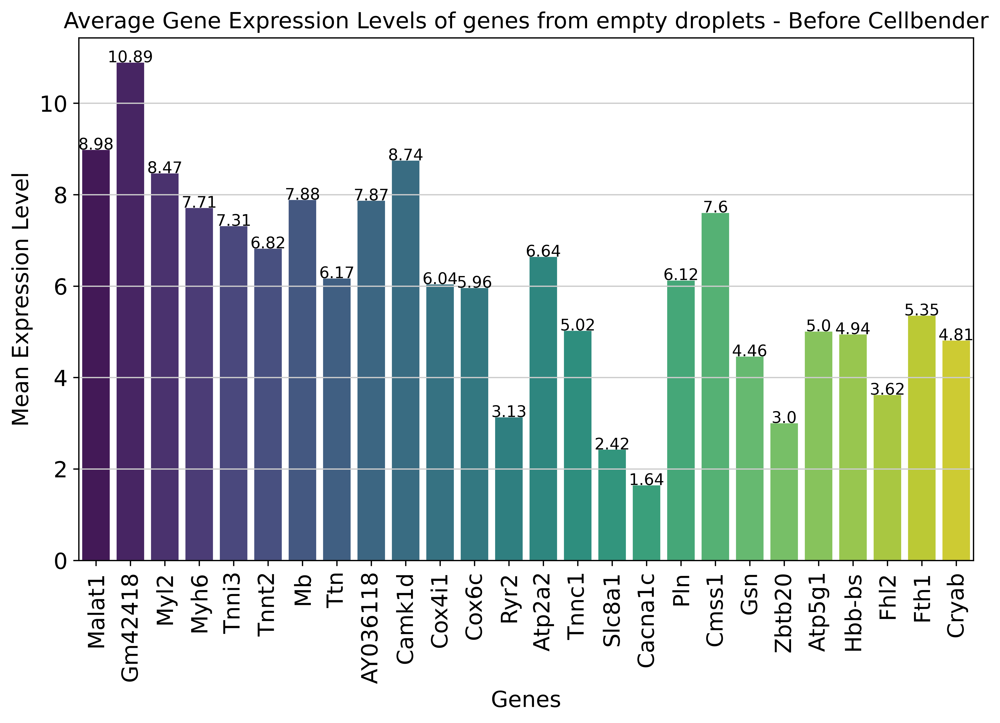

In [14]:
genes_empty_droplets = ['Malat1', 'Gm42418', 'Myl2','Myh6', 'Tnni3', 'Tnnt2', 'Mb', 'Ttn', 'AY036118', 'Camk1d','Cox4i1','Cox6c', 'Ryr2', 'Atp2a2', 'Tnnc1', 'Slc8a1', 'Cacna1c', 'Pln','Cmss1', 'Gsn','Zbtb20','Atp5g1','Hbb-bs','Fhl2','Fth1','Cryab']
present_empty_genes = [gene for gene in genes_empty_droplets if gene in bbknn_raw_before_cb_raw.var.index]

gene_expression_data = bbknn_raw_before_cb_raw[:, present_empty_genes].X
gene_expression_df = pd.DataFrame(gene_expression_data.toarray(), columns=present_empty_genes)

gene_mean_expression = gene_expression_df.mean(axis=0)
gene_mean_expression_df = pd.DataFrame({'Gene': gene_mean_expression.index, 'Mean Expression': gene_mean_expression.values})

plt.figure(figsize=(10, 6))
bar_plot = sns.barplot(x='Gene', y='Mean Expression', data=gene_mean_expression_df, palette='viridis')

for index, row in gene_mean_expression_df.iterrows():
    bar_plot.text(index, row['Mean Expression'] + 0.01, round(row['Mean Expression'], 2), color='black', ha="center", fontsize = 10)

plt.xticks(rotation=90)
plt.title('Average Gene Expression Levels of genes from empty droplets - Before Cellbender')
plt.xlabel('Genes')
plt.ylabel('Mean Expression Level')
plt.show()

### Label Transfer - Barcode mapping

In [15]:
ref.obs.index

Index(['ACACTGATCATTATCC-1-A9_2', 'TCTTCCTGTCATAACC-1-A9_2',
       'ATCTCTAGTTTCAGAC-1-A9_2', 'TGAATGCAGCTCCATA-1-A9_2',
       'GCAGCTGCACAAGTGG-1-A9_2', 'GAGACTTCAGTTAGAA-1-A9_2',
       'CCGATCTTCGCACGGT-1-A9_2', 'TAACTTCTCACAGAGG-1-A9_2',
       'CAACGATGTCTACGTA-1-A9_2', 'ATCGATGGTACCTAGT-1-A9_2',
       ...
       'TGACCCTAGCACCTGC-1-A12_2', 'CCGGACAGTAGCGCTC-1-A12_2',
       'ATTCGTTTCACGTCCT-1-A12_2', 'GTCTCACAGTGTTCAC-1-A12_2',
       'CATAAGCAGTGTCATC-1-A12_2', 'GGTGATTCACCATATG-1-A12_2',
       'TGGTAGTTCATTCGTT-1-A12_2', 'CAACCTCGTGCATTAC-1-A12_2',
       'GTGTGGCAGAAATCCA-1-A12_2', 'CACTGGGTCAACGAGG-1-A12_2'],
      dtype='object', length=117208)

In [16]:
bbknn_raw_before_cb_raw.obs.index

Index(['AAACCCAAGAAGGTAG-1', 'AAACCCAAGAGAGTGA-1', 'AAACCCAAGATGGCAC-1',
       'AAACCCAAGCACGTCC-1', 'AAACCCAAGCCTAACT-1', 'AAACCCAAGCCTCGTG-1',
       'AAACCCAAGGAATGTT-1', 'AAACCCAAGGCCATAG-1', 'AAACCCAAGGCCGCTT-1',
       'AAACCCAAGGGCAGTT-1',
       ...
       'TTTGTTGGTGGCCTCA-1', 'TTTGTTGGTGTCCCTT-1', 'TTTGTTGGTTGGTACT-1',
       'TTTGTTGTCATTTGTC-1', 'TTTGTTGTCCGACAGC-1', 'TTTGTTGTCCTACACC-1',
       'TTTGTTGTCCTACCGT-1', 'TTTGTTGTCGCTGTCT-1', 'TTTGTTGTCTCGCCTA-1',
       'TTTGTTGTCTCTCTTC-1'],
      dtype='object', length=349081)

In [17]:
ref_barcodes = pd.DataFrame(ref.obs.index, columns= ['barcodes'])
ref_barcodes

,barcodes
0,ACACTGATCATTATCC-1-A9_2
1,TCTTCCTGTCATAACC-1-A9_2
2,ATCTCTAGTTTCAGAC-1-A9_2
3,TGAATGCAGCTCCATA-1-A9_2
4,GCAGCTGCACAAGTGG-1-A9_2
...,...
117203,GGTGATTCACCATATG-1-A12_2
117204,TGGTAGTTCATTCGTT-1-A12_2
117205,CAACCTCGTGCATTAC-1-A12_2
117206,GTGTGGCAGAAATCCA-1-A12_2


In [18]:
def remove_after_last_hyphen(barcode):
    return barcode.rsplit('-', 1)[0] 

In [19]:
ref_barcodes['cleaned_barcodes'] = ref_barcodes['barcodes'].apply(remove_after_last_hyphen)
ref_barcodes['cell_type-broad'] = ref.obs['cell_type-broad'].values
ref_barcodes

,barcodes,cleaned_barcodes,cell_type-broad
0,ACACTGATCATTATCC-1-A9_2,ACACTGATCATTATCC-1,cardiomyocytes
1,TCTTCCTGTCATAACC-1-A9_2,TCTTCCTGTCATAACC-1,cardiomyocytes
2,ATCTCTAGTTTCAGAC-1-A9_2,ATCTCTAGTTTCAGAC-1,cardiomyocytes
3,TGAATGCAGCTCCATA-1-A9_2,TGAATGCAGCTCCATA-1,cardiomyocytes
4,GCAGCTGCACAAGTGG-1-A9_2,GCAGCTGCACAAGTGG-1,cardiomyocytes
...,...,...,...
117203,GGTGATTCACCATATG-1-A12_2,GGTGATTCACCATATG-1,myeloid
117204,TGGTAGTTCATTCGTT-1-A12_2,TGGTAGTTCATTCGTT-1,myeloid
117205,CAACCTCGTGCATTAC-1-A12_2,CAACCTCGTGCATTAC-1,myeloid
117206,GTGTGGCAGAAATCCA-1-A12_2,GTGTGGCAGAAATCCA-1,myeloid


In [20]:
if len(ref_barcodes['cleaned_barcodes']) == ref.obs.shape[0]:

    ref.obs.index = ref_barcodes['cleaned_barcodes'].values
else:
    print(f"Length mismatch: {len(ref_barcodes['cleaned_barcodes'])} vs {ref.obs.shape[0]}")

print(ref.obs.index)

Index(['ACACTGATCATTATCC-1', 'TCTTCCTGTCATAACC-1', 'ATCTCTAGTTTCAGAC-1',
       'TGAATGCAGCTCCATA-1', 'GCAGCTGCACAAGTGG-1', 'GAGACTTCAGTTAGAA-1',
       'CCGATCTTCGCACGGT-1', 'TAACTTCTCACAGAGG-1', 'CAACGATGTCTACGTA-1',
       'ATCGATGGTACCTAGT-1',
       ...
       'TGACCCTAGCACCTGC-1', 'CCGGACAGTAGCGCTC-1', 'ATTCGTTTCACGTCCT-1',
       'GTCTCACAGTGTTCAC-1', 'CATAAGCAGTGTCATC-1', 'GGTGATTCACCATATG-1',
       'TGGTAGTTCATTCGTT-1', 'CAACCTCGTGCATTAC-1', 'GTGTGGCAGAAATCCA-1',
       'CACTGGGTCAACGAGG-1'],
      dtype='object', length=117208)


In [21]:
bbknn_raw_before_cb_raw_barcodes = pd.DataFrame(bbknn_raw_before_cb_raw.obs.index, columns= ['barcodes'])
bbknn_raw_before_cb_raw_barcodes

,barcodes
0,AAACCCAAGAAGGTAG-1
1,AAACCCAAGAGAGTGA-1
2,AAACCCAAGATGGCAC-1
3,AAACCCAAGCACGTCC-1
4,AAACCCAAGCCTAACT-1
...,...
349076,TTTGTTGTCCTACACC-1
349077,TTTGTTGTCCTACCGT-1
349078,TTTGTTGTCGCTGTCT-1
349079,TTTGTTGTCTCGCCTA-1


In [22]:
bbknn_raw_before_cb_raw_barcodes['cleaned_barcodes'] = bbknn_raw_before_cb_raw_barcodes['barcodes']
bbknn_raw_before_cb_raw_barcodes

,barcodes,cleaned_barcodes
0,AAACCCAAGAAGGTAG-1,AAACCCAAGAAGGTAG-1
1,AAACCCAAGAGAGTGA-1,AAACCCAAGAGAGTGA-1
2,AAACCCAAGATGGCAC-1,AAACCCAAGATGGCAC-1
3,AAACCCAAGCACGTCC-1,AAACCCAAGCACGTCC-1
4,AAACCCAAGCCTAACT-1,AAACCCAAGCCTAACT-1
...,...,...
349076,TTTGTTGTCCTACACC-1,TTTGTTGTCCTACACC-1
349077,TTTGTTGTCCTACCGT-1,TTTGTTGTCCTACCGT-1
349078,TTTGTTGTCGCTGTCT-1,TTTGTTGTCGCTGTCT-1
349079,TTTGTTGTCTCGCCTA-1,TTTGTTGTCTCGCCTA-1


In [23]:
mapping_dict = pd.Series(ref_barcodes['cell_type-broad'].values, index=ref_barcodes['cleaned_barcodes']).to_dict()
mapping_dict

{'ACACTGATCATTATCC-1': 'cardiomyocytes',
 'TCTTCCTGTCATAACC-1': 'cardiomyocytes',
 'ATCTCTAGTTTCAGAC-1': 'cardiomyocytes',
 'TGAATGCAGCTCCATA-1': 'cardiomyocytes',
 'GCAGCTGCACAAGTGG-1': 'cardiomyocytes',
 'GAGACTTCAGTTAGAA-1': 'cardiomyocytes',
 'CCGATCTTCGCACGGT-1': 'cardiomyocytes',
 'TAACTTCTCACAGAGG-1': 'cardiomyocytes',
 'CAACGATGTCTACGTA-1': 'cardiomyocytes',
 'ATCGATGGTACCTAGT-1': 'cardiomyocytes',
 'TTTGGTTCATCAACCA-1': 'cardiomyocytes',
 'AATCGTGAGAATTTGG-1': 'cardiomyocytes',
 'CTTCCGAGTCCCAAAT-1': 'cardiomyocytes',
 'AATTCCTTCACCGACG-1': 'cardiomyocytes',
 'TAGAGTCCACACCTTC-1': 'cardiomyocytes',
 'ATTCACTTCCTCACTG-1': 'cardiomyocytes',
 'GTTCCGTTCCCTCGTA-1': 'cardiomyocytes',
 'GACGTTAAGGAAAGGT-1': 'cardiomyocytes',
 'TCACATTCATTCACCC-1': 'cardiomyocytes',
 'CATTGCCCACGACGCT-1': 'cardiomyocytes',
 'GATCACATCGCTTAAG-1': 'lymphoid',
 'AACCTGAGTCACTCAA-1': 'cardiomyocytes',
 'CTACTATGTAGCGATG-1': 'cardiomyocytes',
 'CACAACATCGTTCTAT-1': 'cardiomyocytes',
 'GTGAGCCAGACGTCCC-1':

In [24]:
bbknn_raw_before_cb_raw_barcodes['cell_type-broad'] = ref_barcodes['cleaned_barcodes'].map(mapping_dict).fillna('Unmatched')
bbknn_raw_before_cb_raw.obs['cell_type-broad'] = bbknn_raw_before_cb_raw_barcodes['cell_type-broad'].values
bbknn_raw_before_cb_raw.obs['cell_type-broad'].value_counts()

cell_type-broad
lymphoid           50293
myeloid            27888
vascular states    22489
fibroblasts         9495
cardiomyocytes      7043
Name: count, dtype: int64

In [25]:
bbknn_raw_before_cb_raw

AnnData object with n_obs × n_vars = 349081 × 32285
    obs: 'sample', 'genotype', 'n_genes_by_counts', 'total_counts', 'total_counts_mt', 'pct_counts_mt', 'total_counts_ribo', 'pct_counts_ribo', 'n_counts', 'cell_type-broad'
    var: 'mt', 'ribo', 'n_cells_by_counts', 'mean_counts', 'pct_dropout_by_counts', 'total_counts', 'highly_variable', 'highly_variable_rank', 'means', 'variances', 'variances_norm', 'highly_variable_nbatches'
    uns: 'sample_colors', 'hvg', 'log1p', 'pca', 'neighbors'
    obsm: 'X_pca'
    varm: 'PCs'
    layers: 'counts', 'sqrt_norm', 'normalized'
    obsp: 'distances', 'connectivities'

## Data visualization

computing UMAP
    finished: added
    'X_umap', UMAP coordinates (adata.obsm) (0:04:37)


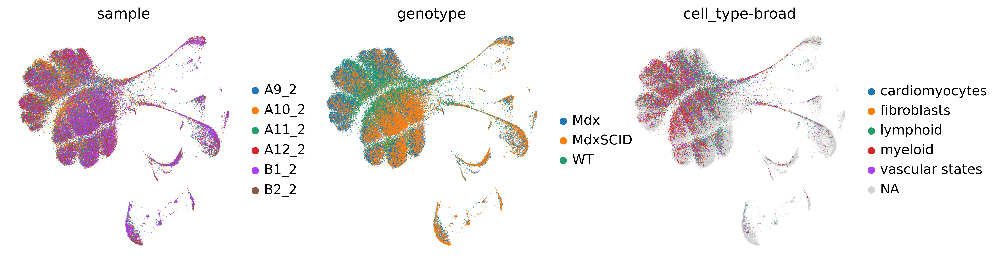

In [26]:
sc.tl.umap(bbknn_raw_before_cb_raw, min_dist = 0.4, spread = 3, random_state = 1789)
sc.pl.umap(bbknn_raw_before_cb_raw, color = ['sample', 'genotype','cell_type-broad'], frameon =False, layer = 'normalized')

In [27]:
bbknn_raw_before_cb_raw.obs['cell_type-broad'].value_counts()

cell_type-broad
lymphoid           50293
myeloid            27888
vascular states    22489
fibroblasts         9495
cardiomyocytes      7043
Name: count, dtype: int64

In [28]:
genes_of_interest = ['Il2','Tnnt2','Il10', 'Ttn','Dcn','Myh7', 'Dmd','Ctnna3','Lama2','Ryr2','Cd19','Cd3e','Cd44', 'Vwf', 'Myh11', 'Rgs4', 'Kcnj8', 'C1qa', 'Nrxn1', 'Adipoq', 'Trem2']
present_genes = [gene for gene in genes_of_interest if gene in bbknn_raw_before_cb_raw.var.index]

In [29]:
sc.pl.umap(bbknn_raw_before_cb_raw, color = present_genes, frameon =False, layer = 'normalized')

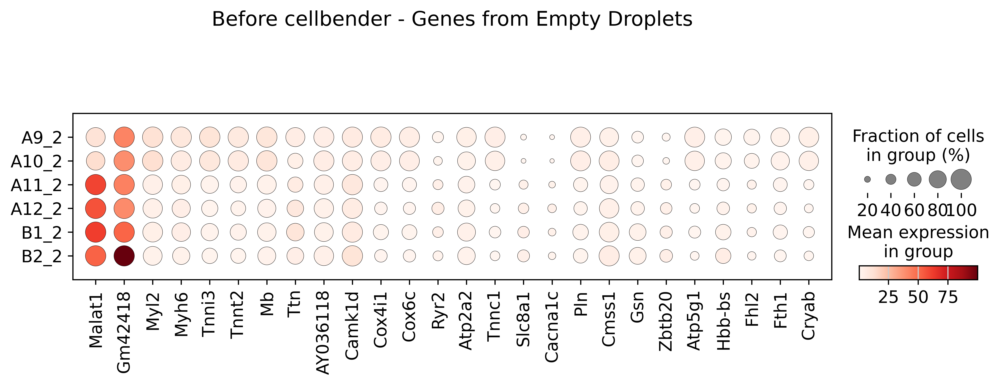

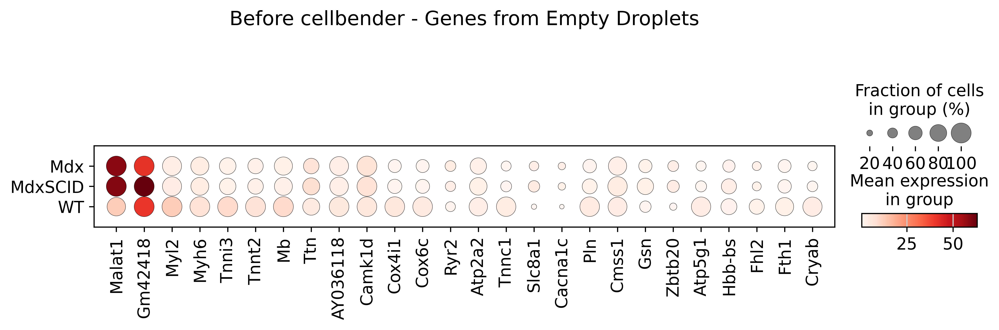

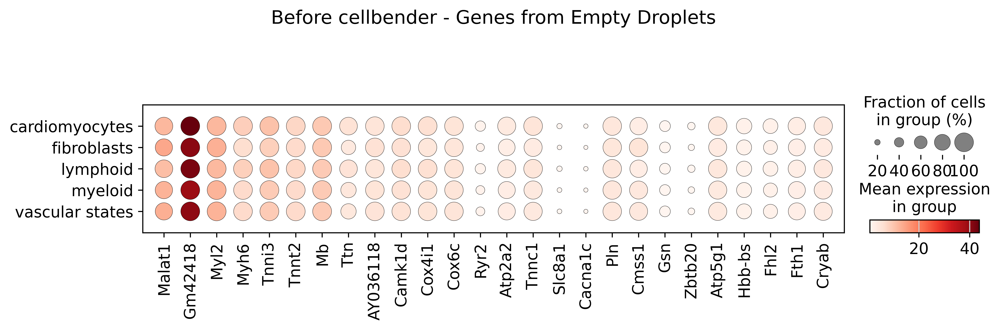

In [30]:
sc.pl.dotplot(bbknn_raw_before_cb_raw, var_names= present_empty_genes, groupby= 'sample', title = 'Before cellbender - Genes from Empty Droplets')
sc.pl.dotplot(bbknn_raw_before_cb_raw, var_names= present_empty_genes, groupby= 'genotype', title ='Before cellbender - Genes from Empty Droplets')
sc.pl.dotplot(bbknn_raw_before_cb_raw, var_names= present_empty_genes, groupby= 'cell_type-broad', title ='Before cellbender - Genes from Empty Droplets')

/tmp/ipykernel_34129/2803448850.py:8: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  mean_expression_per_cell_type = gene_expression_df.groupby('cell_type-broad').mean().reset_index()


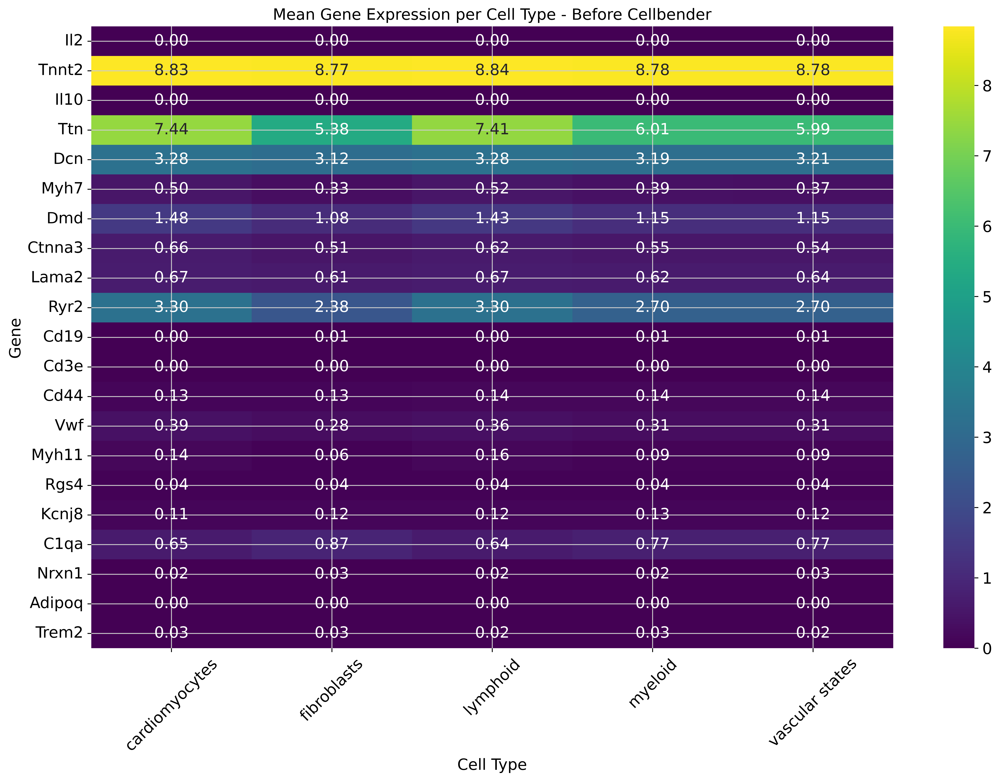

In [31]:
gene_expression_data = bbknn_raw_before_cb_raw[:, present_genes].X
if hasattr(gene_expression_data, 'toarray'):
    gene_expression_data = gene_expression_data.toarray()

gene_expression_df = pd.DataFrame(gene_expression_data, columns=present_genes)
gene_expression_df['cell_type-broad'] = bbknn_raw_before_cb_raw.obs['cell_type-broad'].values

mean_expression_per_cell_type = gene_expression_df.groupby('cell_type-broad').mean().reset_index()

mean_expression_long = mean_expression_per_cell_type.melt(id_vars='cell_type-broad', var_name='Gene', value_name='Mean Expression')

plt.figure(figsize=(14, 10))
sns.heatmap(mean_expression_per_cell_type.set_index('cell_type-broad').T, cmap='viridis', annot=True, fmt='.2f', linecolor= None, linewidths= 0)
plt.title('Mean Gene Expression per Cell Type - Before Cellbender')
plt.xlabel('Cell Type')
plt.ylabel('Gene')
plt.xticks(rotation=45)
plt.tight_layout()
plt.show()

In [32]:
bbknn_raw_before_cb_raw.write_h5ad(f'../../raw_data/raw_anndatas/dmd_merged_filtered_before_cb_annotated_{timestamp}.h5ad')